<a href="https://colab.research.google.com/github/mto0501/Internetprojects/blob/main/Transfer%20learning%20Image%20classification%20%20.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
import matplotlib.pyplot as plt
import numpy as np
import os, tarfile
import pathlib
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers, models

In [3]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
def acc_loss_graph(history):
  #-----------------------------------------------------------
  # Retrieve a list of list results on training and test data
  # sets for each training epoch
  #-----------------------------------------------------------
  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  epochs = range(len(acc))
  #------------------------------------------------
  # Plot training and validation accuracy per epoch
  #------------------------------------------------
  plt.plot(epochs, acc, 'b', label='Training accuracy')
  plt.plot(epochs, val_acc, 'r', label='Validation accuracy')
  plt.legend()
  plt.title('Training and validation accuracy')

  plt.figure()
  #------------------------------------------------
  # Plot training and validation loss per epoch
  #------------------------------------------------
  plt.plot(epochs, loss, 'b', label='Training Loss')
  plt.plot(epochs, val_loss, 'r', label='Validation Loss')
  plt.title('Training and validation loss')
  plt.legend()

  plt.show()

In [ ]:
!pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"hmto0501","key":"fcd149e7668b7efd45cd5c24dcf7c7cb"}'}

In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
!kaggle datasets download -d puneet6060/intel-image-classification  -p /content/gdrive/MyDrive/week7_project

 98% 341M/346M [00:10<00:00, 28.6MB/s]
100% 346M/346M [00:10<00:00, 35.6MB/s]


In [4]:
import zipfile
import os
import shutil

In [ ]:
# Now you can Unzip it!
# !unzip -q <SOURCE-PATH> -d <DESTINATION-PATH>

!unzip -q /content/gdrive/MyDrive/intel-image-classification.zip -d /content/gdrive/MyDrive/week7_project

In [107]:
# PATH only, not creating yet
import pathlib


base_dir = pathlib.Path('/content/gdrive/MyDrive/week7_project')

train_dir = pathlib.Path('/content/gdrive/MyDrive/week7_project/seg_train/seg_train')
validation_dir = pathlib.Path('/content/gdrive/MyDrive/week7_project/seg_test/seg_test')

# Directory training pictures
train_buildings_dir =  train_dir/'buildings'
train_forest_dir =  train_dir/'forest'
train_glacier_dir =  train_dir/'glacier'
train_mountain_dir = train_dir/'mountain'
train_sea_dir =  train_dir/'sea'
train_street_dir =  train_dir/'street'

# Directory validation pictures
validation_buildings_dir = validation_dir/'buildings'
validation_forest_dir =  validation_dir/'forest'
validation_glacier_dir =  validation_dir/'glacier'
validation_mountain_dir = validation_dir/'mountain'
validation_sea_dir = validation_dir/'sea'
validation_street_dir = validation_dir/'street'

In [21]:
!mkdir -p /content/gdrive/MyDrive/week7_project/Result/Saved_model
!mkdir -p /content/gdrive/MyDrive/week7_project/Result/

RESULT            = base_dir/'Results'
SAVED_MODEL       = RESULT/'Saved_model'

In [6]:
train_buildings_fnames = os.listdir( train_buildings_dir )
train_forest_fnames = os.listdir( train_forest_dir )
train_glacier_fnames = os.listdir( train_glacier_dir )
train_mountain_fnames = os.listdir( train_mountain_dir )
train_sea_fnames = os.listdir( train_sea_dir )
train_street_fnames = os.listdir( train_street_dir )

In [7]:
print(train_buildings_fnames[:10])
print(train_forest_fnames[:10])
print(train_glacier_fnames[:10])
print(train_mountain_fnames[:10])
print(train_sea_fnames[:10])
print(train_street_fnames[:10])

['1954.jpg', '19608.jpg', '19440.jpg', '19466.jpg', '19416.jpg', '1955.jpg', '19584.jpg', '1943.jpg', '19624.jpg', '19513.jpg']
['23.jpg', '2294.jpg', '2126.jpg', '2255.jpg', '2292.jpg', '2232.jpg', '2044.jpg', '2107.jpg', '2310.jpg', '2284.jpg']
['2429.jpg', '2159.jpg', '2440.jpg', '2510.jpg', '2567.jpg', '2323.jpg', '2223.jpg', '2420.jpg', '2511.jpg', '2280.jpg']
['293.jpg', '3050.jpg', '3024.jpg', '3005.jpg', '3047.jpg', '305.jpg', '2976.jpg', '3090.jpg', '3030.jpg', '2932.jpg']
['2086.jpg', '2349.jpg', '2644.jpg', '2439.jpg', '2546.jpg', '2358.jpg', '2154.jpg', '2623.jpg', '224.jpg', '2062.jpg']
['2210.jpg', '2045.jpg', '2164.jpg', '2089.jpg', '2082.jpg', '2178.jpg', '2188.jpg', '2103.jpg', '2186.jpg', '2169.jpg']


In [8]:
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

# Parameters for our graph; we'll output images in a 4x4 configuration
nrows = 12
ncols = 4

pic_index = 0 # Index for iterating over images

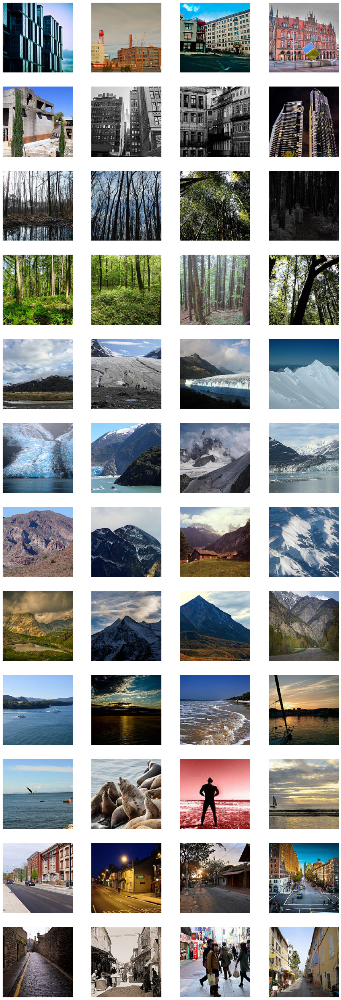

In [9]:
# Set up matplotlib fig, and size it to fit 4x4 pics
fig = plt.figure()
fig.set_size_inches(ncols*4, nrows*4)

pic_index+=8

next_buildings_pix = [os.path.join(train_buildings_dir, fname) 
for fname in train_buildings_fnames[ pic_index-8:pic_index]]

next_forest_pix = [os.path.join(train_forest_dir, fname) 
for fname in train_forest_fnames[ pic_index-8:pic_index]]

next_glacier_pix = [os.path.join(train_glacier_dir,fname) 
for fname in train_glacier_fnames[ pic_index-8:pic_index]]

next_mountain_pix = [os.path.join(train_mountain_dir,fname)
for fname in train_mountain_fnames[ pic_index-8:pic_index]]

next_sea_pix = [os.path.join(train_sea_dir, fname)
for fname in train_sea_fnames[ pic_index-8:pic_index]]

next_street_pix = [os.path.join(train_street_dir,fname)
for fname in train_street_fnames[ pic_index-8:pic_index]]

for i, img_path in enumerate(next_buildings_pix + next_forest_pix + next_glacier_pix + next_mountain_pix + next_sea_pix + next_street_pix):
  # Set up subplot; subplot indices start at 1
  sp = plt.subplot(nrows, ncols, i + 1)
  sp.axis('Off') # Don't show axes (or gridlines)

  img = mpimg.imread(img_path)
  plt.imshow(img)

plt.show()

In [10]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

IMG_SIZE = 224
BATCH_SIZE = 32

def generator_augmentation_maker():
  train_gen = ImageDataGenerator(
        rotation_range=30,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.1,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest',
        validation_split=0.2) # IMPORTANT
  
  val_gen = ImageDataGenerator(validation_split=0.2)  # IMPORTANT

  train_generator = train_gen.flow_from_directory(
          train_dir,  
          target_size=(IMG_SIZE, IMG_SIZE),  
          batch_size=BATCH_SIZE,
          class_mode='categorical',
          shuffle=True,
          seed=42,            # IMPORTANT
          subset='training')  # IMPORTANT

  validation_generator = val_gen.flow_from_directory(
          validation_dir,
          target_size=(IMG_SIZE, IMG_SIZE),
          batch_size=BATCH_SIZE,
          class_mode='categorical',
          shuffle=False,        # IMPORTANT
          seed=42,              # IMPORTANT
          subset='validation')  # IMPORTANT
  return train_generator, validation_generator

In [11]:
train_generator, validation_generator = generator_augmentation_maker()

Found 11230 images belonging to 6 classes.
Found 598 images belonging to 6 classes.


In [12]:
  base_model = keras.applications.MobileNetV2(weights='imagenet',
                                              input_shape=(IMG_SIZE, IMG_SIZE, 3),
                                              include_top=False)

  base_model.trainable = False

9420800/9406464 [==============================] - 0s 0us/step


In [13]:
from keras.applications.mobilenet_v2 import preprocess_input
def model_maker():
  inputs = keras.Input(shape=(224,224,3))
  x = preprocess_input(inputs)
  x = base_model(x, training=False)
  x = layers.GlobalAveragePooling2D()(x)
  x = layers.Dropout(0.2)(x)
  outputs = layers.Dense(6, activation='softmax')(x)
  model = keras.Model(inputs, outputs)
  return model

In [14]:
model = model_maker()
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   
 ional)                                                          
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                      

In [15]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',     # BE CAREFUL
              metrics = ['accuracy'])

In [16]:
from keras.callbacks import EarlyStopping, ReduceLROnPlateau 

callback = [EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
            ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-4)]

init_epochs=5

history = model.fit(train_generator,
                    validation_data=validation_generator,
                    epochs=init_epochs,
                    callbacks = callback)

Epoch 1/5
351/351 [==============================] - 2040s 6s/step - loss: 0.5540 - accuracy: 0.7950 - val_loss: 0.3014 - val_accuracy: 0.8863 - lr: 0.0010
Epoch 2/5
351/351 [==============================] - 129s 368ms/step - loss: 0.3785 - accuracy: 0.8618 - val_loss: 0.2887 - val_accuracy: 0.8880 - lr: 0.0010
Epoch 3/5
351/351 [==============================] - 128s 364ms/step - loss: 0.3511 - accuracy: 0.8702 - val_loss: 0.2742 - val_accuracy: 0.8880 - lr: 0.0010
Epoch 4/5
351/351 [==============================] - 128s 365ms/step - loss: 0.3312 - accuracy: 0.8770 - val_loss: 0.3031 - val_accuracy: 0.8913 - lr: 0.0010
Epoch 5/5
351/351 [==============================] - 128s 364ms/step - loss: 0.3305 - accuracy: 0.8783 - val_loss: 0.3078 - val_accuracy: 0.8763 - lr: 0.0010


In [17]:
model.evaluate(validation_generator)

19/19 [==============================] - 2s 81ms/step - loss: 0.3078 - accuracy: 0.8763


[0.3078458905220032, 0.8762542009353638]

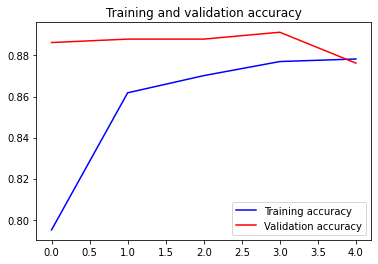

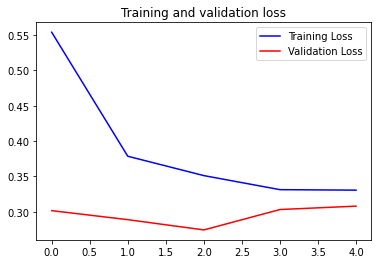

In [18]:
acc_loss_graph(history)

### Fine-tuning

In [19]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

Number of layers in the base model:  154


In [20]:
# Unfreeze the base_model.
base_model.trainable = True

# Fine-tune from this layer onwards
fine_tune_at = 150

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5), # default 0.001
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   
 ional)                                                          
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                      

In [22]:
# CALLBACK and TRAIN

# Stopped by EarlyStopping: model is auto-restored best weights => can CONTINUE to finetune
# Stopped by user => LOAD model_ckpt to continue
# Stopped by finishing => model saved to Saved_model

from keras.callbacks import ModelCheckpoint

callbacks = [EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1),
             ModelCheckpoint(monitor='val_loss', filepath=RESULT/'model_ckpt.h5', save_weights_only=False, save_best_only=True, verbose=1)]

init_epochs = 5
fine_tune_epochs = 15
total_epochs = init_epochs + fine_tune_epochs

history_fine = model.fit(train_generator, 
                         validation_data=validation_generator,
                         epochs=total_epochs,
                         initial_epoch=init_epochs,
                         callbacks=callbacks)

model.save(SAVED_MODEL)

Epoch 6/20
351/351 [==============================] - ETA: 0s - loss: 0.3104 - accuracy: 0.8861
Epoch 00006: val_loss improved from inf to 0.26292, saving model to /content/gdrive/MyDrive/week7_project/Results/model_ckpt.h5


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


351/351 [==============================] - 132s 369ms/step - loss: 0.3104 - accuracy: 0.8861 - val_loss: 0.2629 - val_accuracy: 0.8997
Epoch 7/20
351/351 [==============================] - ETA: 0s - loss: 0.2982 - accuracy: 0.8883
Epoch 00007: val_loss improved from 0.26292 to 0.25964, saving model to /content/gdrive/MyDrive/week7_project/Results/model_ckpt.h5
351/351 [==============================] - 129s 368ms/step - loss: 0.2982 - accuracy: 0.8883 - val_loss: 0.2596 - val_accuracy: 0.8980
Epoch 8/20
351/351 [==============================] - ETA: 0s - loss: 0.2914 - accuracy: 0.8908
Epoch 00008: val_loss improved from 0.25964 to 0.25950, saving model to /content/gdrive/MyDrive/week7_project/Results/model_ckpt.h5
351/351 [==============================] - 130s 369ms/step - loss: 0.2914 - accuracy: 0.8908 - val_loss: 0.2595 - val_accuracy: 0.9013
Epoch 9/20
351/351 [==============================] - ETA: 0s - loss: 0.2854 - accuracy: 0.8963
Epoch 00009: val_loss improved from 0.25950

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


In [23]:
model.evaluate(validation_generator)

19/19 [==============================] - 2s 83ms/step - loss: 0.2349 - accuracy: 0.9030


[0.2349424809217453, 0.9030100107192993]

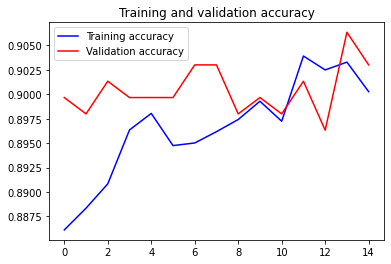

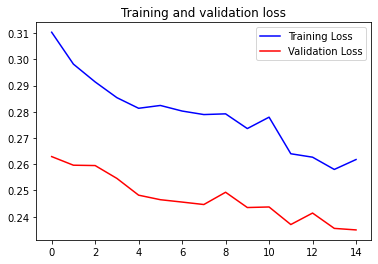

In [25]:
acc_loss_graph(history_fine)

###  Model evaluation

In [26]:
validation_generator.class_indices

{'buildings': 0,
 'forest': 1,
 'glacier': 2,
 'mountain': 3,
 'sea': 4,
 'street': 5}

In [27]:
ground_truth = validation_generator.classes
ground_truth[:]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,

In [28]:
filenames = validation_generator.filenames
filenames

['buildings/20057.jpg',
 'buildings/20060.jpg',
 'buildings/20061.jpg',
 'buildings/20064.jpg',
 'buildings/20073.jpg',
 'buildings/20074.jpg',
 'buildings/20078.jpg',
 'buildings/20083.jpg',
 'buildings/20094.jpg',
 'buildings/20096.jpg',
 'buildings/20113.jpg',
 'buildings/20131.jpg',
 'buildings/20140.jpg',
 'buildings/20177.jpg',
 'buildings/20186.jpg',
 'buildings/20206.jpg',
 'buildings/20207.jpg',
 'buildings/20218.jpg',
 'buildings/20228.jpg',
 'buildings/20231.jpg',
 'buildings/20241.jpg',
 'buildings/20245.jpg',
 'buildings/20246.jpg',
 'buildings/20250.jpg',
 'buildings/20268.jpg',
 'buildings/20294.jpg',
 'buildings/20309.jpg',
 'buildings/20344.jpg',
 'buildings/20350.jpg',
 'buildings/20366.jpg',
 'buildings/20374.jpg',
 'buildings/20390.jpg',
 'buildings/20394.jpg',
 'buildings/20424.jpg',
 'buildings/20425.jpg',
 'buildings/20430.jpg',
 'buildings/20431.jpg',
 'buildings/20436.jpg',
 'buildings/20441.jpg',
 'buildings/20449.jpg',
 'buildings/20460.jpg',
 'buildings/2046

In [59]:
validation_dir

'/content/gdrive/MyDrive/week7_project/seg_test/seg_test'

In [79]:
predictions = model.predict(validation_generator)
pred_indices = np.argmax(predictions,axis=1)

img_paths = list(map(lambda x: str(validation_dir/x), filenames))  

In [80]:
ground_truth[:5] , img_paths[:5]

(array([0, 0, 0, 0, 0], dtype=int32),
 ['/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20057.jpg',
  '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20060.jpg',
  '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20061.jpg',
  '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20064.jpg',
  '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20073.jpg'])

In [81]:
from sklearn.metrics import classification_report

print(classification_report(ground_truth, pred_indices, target_names=list(validation_generator.class_indices.keys())))

              precision    recall  f1-score   support

   buildings       0.92      0.93      0.93        87
      forest       0.97      0.98      0.97        94
     glacier       0.80      0.88      0.84       110
    mountain       0.90      0.76      0.82       105
         sea       0.95      0.94      0.95       102
      street       0.90      0.94      0.92       100

    accuracy                           0.90       598
   macro avg       0.91      0.91      0.91       598
weighted avg       0.90      0.90      0.90       598



##Error analysis 

In [82]:
print(validation_generator.class_indices)

{'buildings': 0, 'forest': 1, 'glacier': 2, 'mountain': 3, 'sea': 4, 'street': 5}


In [83]:
filenames = validation_generator.filenames
print(len(filenames))
print(filenames[500:505], '\n')

ground_truth = validation_generator.classes
print(len(ground_truth))
ground_truth

598
['street/20069.jpg', 'street/20070.jpg', 'street/20075.jpg', 'street/20079.jpg', 'street/20080.jpg'] 

598


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,

In [93]:
predictions = model.predict(validation_generator)

In [94]:
predictions[:10]

array([[9.99500155e-01, 1.70595609e-08, 3.58441781e-07, 2.43823148e-08,
        1.35517791e-06, 4.98148846e-04],
       [8.83593500e-01, 1.19264854e-07, 1.31442694e-05, 1.14409283e-06,
        6.99116526e-07, 1.16391391e-01],
       [9.93893266e-01, 2.48872639e-05, 3.86832871e-05, 8.87461938e-05,
        8.06824319e-05, 5.87369176e-03],
       [9.99974489e-01, 1.81160473e-07, 2.60544851e-07, 1.13618921e-06,
        1.66484870e-06, 2.22109629e-05],
       [9.95169222e-01, 3.38300706e-05, 4.40200296e-04, 2.81258905e-03,
        4.33131441e-04, 1.11102872e-03],
       [8.68456423e-01, 3.33043834e-04, 4.58029518e-03, 2.21699942e-02,
        2.87157041e-03, 1.01588644e-01],
       [9.99812067e-01, 8.82877941e-07, 2.62469348e-05, 1.20129980e-05,
        3.68237015e-05, 1.12023503e-04],
       [1.44360751e-01, 3.58387410e-06, 1.68584738e-04, 1.47242736e-06,
        1.08546362e-06, 8.55464518e-01],
       [9.45358872e-01, 8.41463625e-05, 2.85006154e-05, 3.75048512e-05,
        1.70413441e-05, 

In [95]:
# prediction_table is a dict with index, prediction, ground truth
prediction_table = {}
for index, val in enumerate(predictions):
    # get argmax index
    index_of_highest_probability = np.argmax(val)
    value_of_highest_probability = val[index_of_highest_probability]
    prediction_table[index] = [value_of_highest_probability, 
                               index_of_highest_probability, 
                               ground_truth[index]]
assert len(predictions) == len(ground_truth) == len(prediction_table)


In [98]:
def get_images_with_sorted_probabilities(prediction_table,
                                         get_highest_probability,
                                         label,
                                         number_of_items,
                                         only_false_predictions=False):
    sorted_prediction_table = [(k, prediction_table[k])
                               for k in sorted(prediction_table,
                                               key=prediction_table.get,
                                               reverse=get_highest_probability)
                               ]
    result = []
    for index, key in enumerate(sorted_prediction_table):
        image_index, [probability, predicted_index, gt] = key
        if predicted_index == label:
            if only_false_predictions == True:
                if predicted_index != gt:
                    result.append(
                        [image_index, [probability, predicted_index, gt]])
            else:
                result.append(
                    [image_index, [probability, predicted_index, gt]])
    return result[:number_of_items]

def plot_images(filenames, distances, message):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    plt.figure(figsize=(20, 15))
    columns = 5
    for i, image in enumerate(images):
        ax = plt.subplot(len(images) / columns + 1, columns, i + 1)
        ax.set_title("\n\n" + filenames[i].split("/")[-1] + "\n" +
                     "\nProbability: " +
                     str(float("{0:.2f}".format(distances[i]))))
        plt.suptitle(message, fontsize=20, fontweight='bold')
        plt.axis('off')
        plt.imshow(image)
        
def display(sorted_indices, message):
    similar_image_paths = []
    distances = []
    for name, value in sorted_indices:
        [probability, predicted_index, gt] = value
        similar_image_paths.append(str(validation_dir) + '/' + filenames[name])
        distances.append(probability)
    plot_images(similar_image_paths, distances, message)

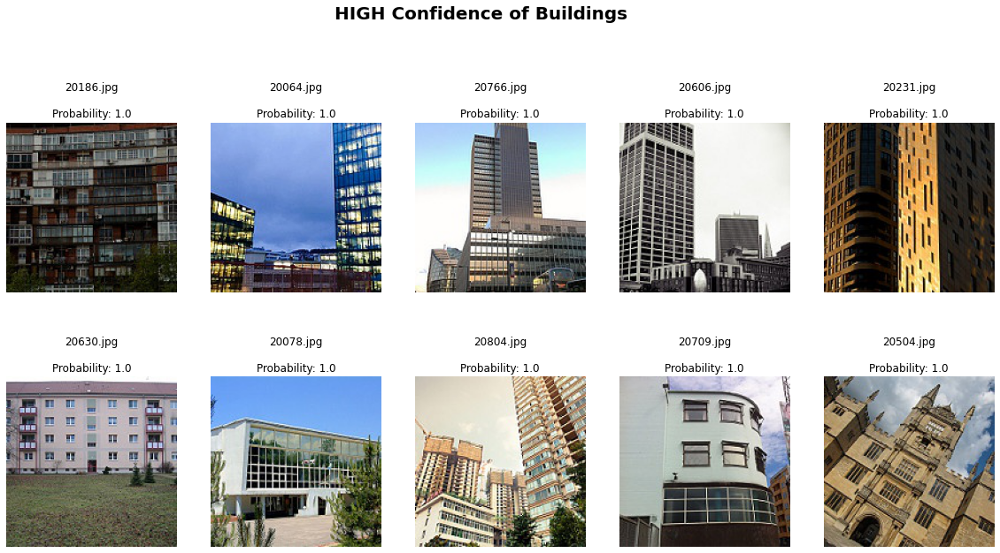

In [99]:
message = 'HIGH Confidence of Buildings'
highest_confident_buildings_images = get_images_with_sorted_probabilities(prediction_table, True, 0, 10, False)
display(highest_confident_buildings_images, message) 

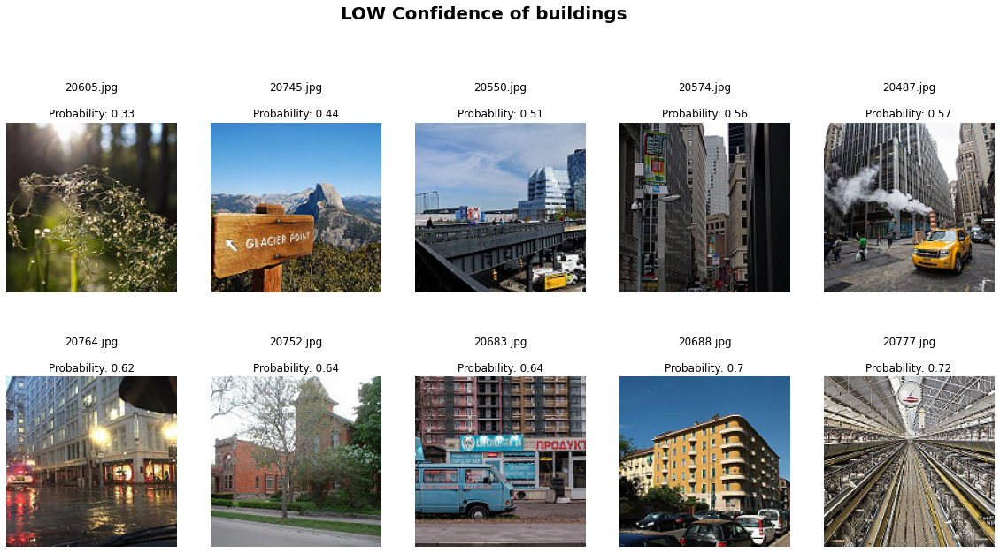

In [102]:
message = 'LOW Confidence of buildings'
lowest_confident_buildings_images = get_images_with_sorted_probabilities(prediction_table, False, 0, 10, False)
display(lowest_confident_buildings_images, message)

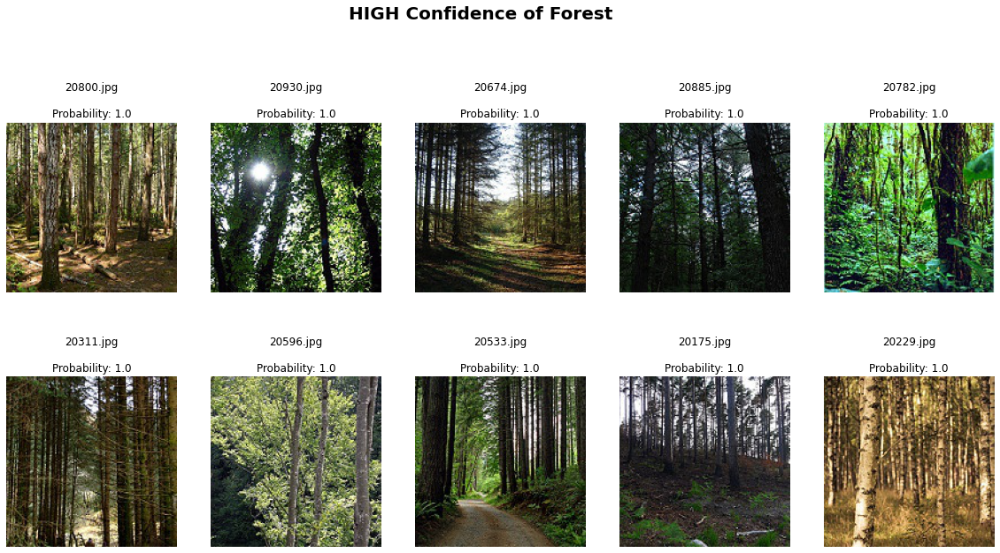

In [101]:
message = 'HIGH Confidence of Forest '
highest_confident_forest_images = get_images_with_sorted_probabilities(prediction_table, True, 1, 10, False)
display(highest_confident_buildings_images, message) 

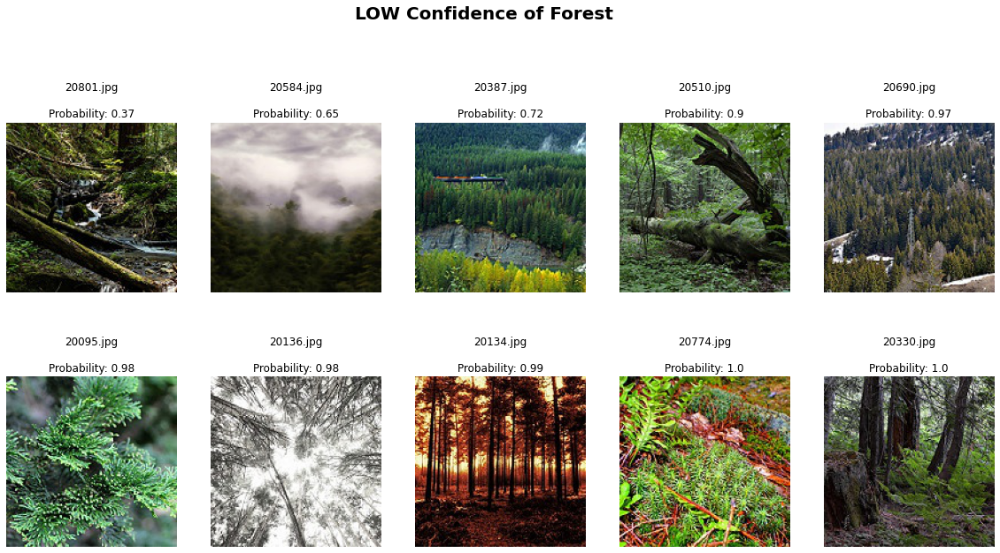

In [108]:
message = 'LOW Confidence of Forest'
lowest_confident_forest_images = get_images_with_sorted_probabilities(prediction_table, False, 1, 10, False)
display(lowest_confident_forest_images, message)

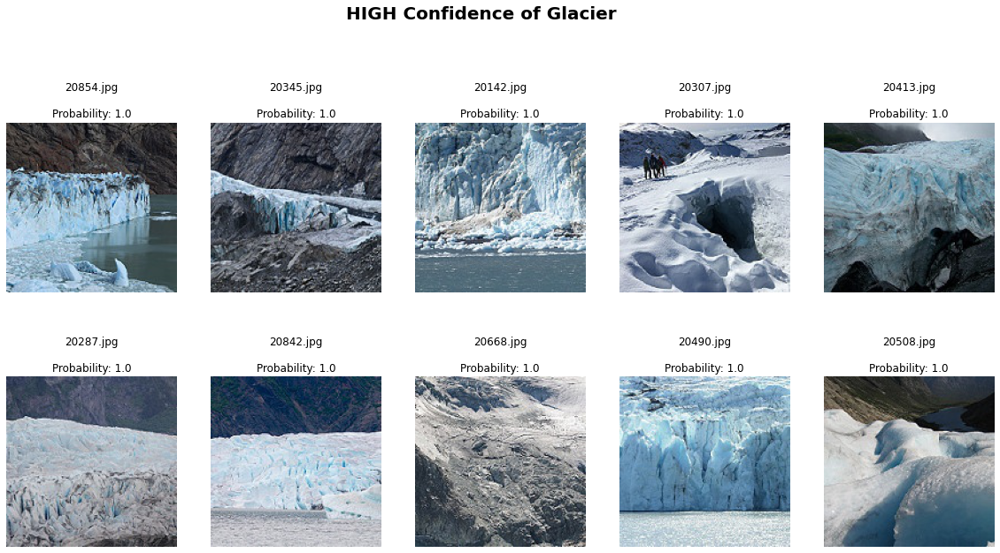

In [104]:
message = 'HIGH Confidence of Glacier '
highest_confident_glacier_images = get_images_with_sorted_probabilities(prediction_table, True, 2, 10, False)
display(highest_confident_glacier_images, message) 

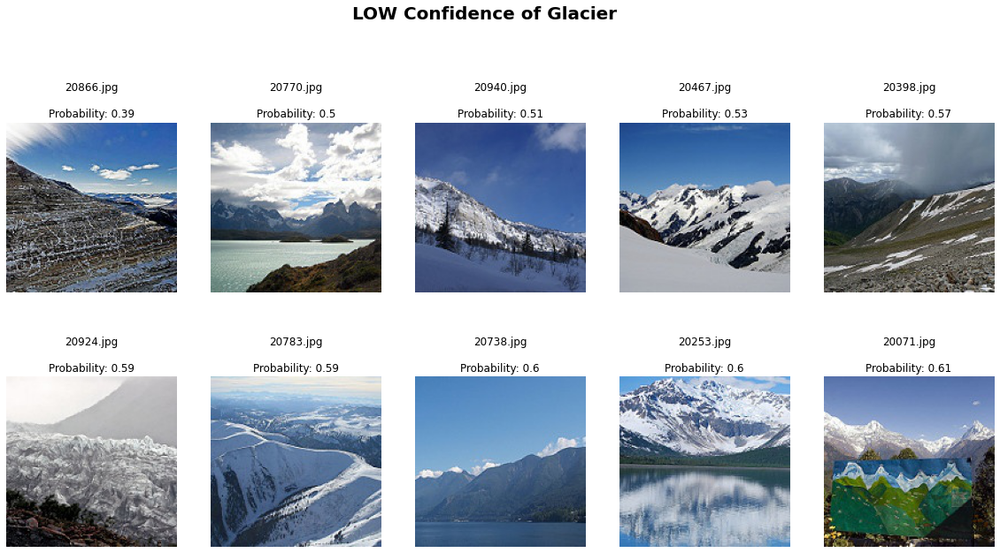

In [105]:
message = 'LOW Confidence of Glacier'
lowest_confident_glacier_images = get_images_with_sorted_probabilities(prediction_table, False, 2, 10, False)
display(lowest_confident_glacier_images, message)

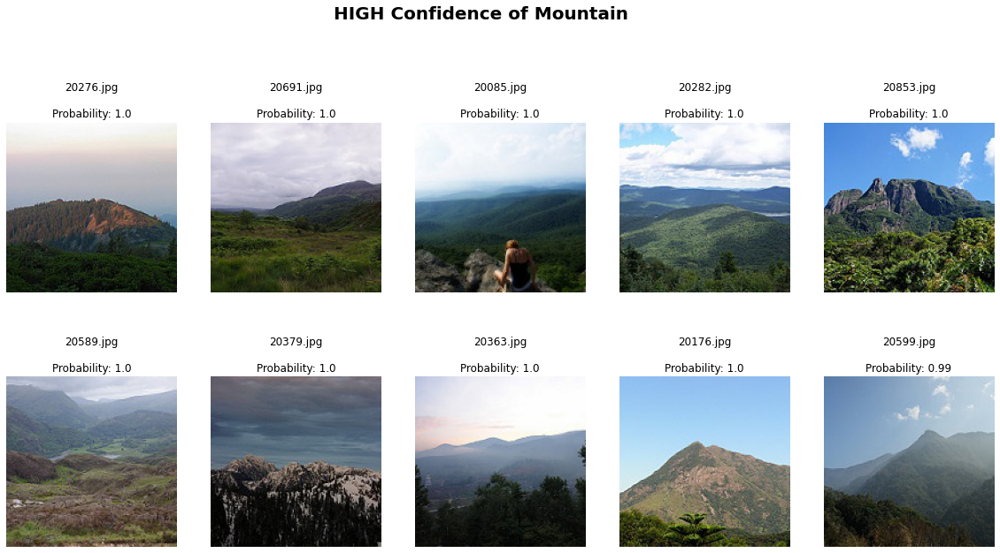

In [106]:
message = 'HIGH Confidence of Mountain '
highest_confident_mountain_images = get_images_with_sorted_probabilities(prediction_table, True, 3, 10, False)
display(highest_confident_mountain_images, message) 

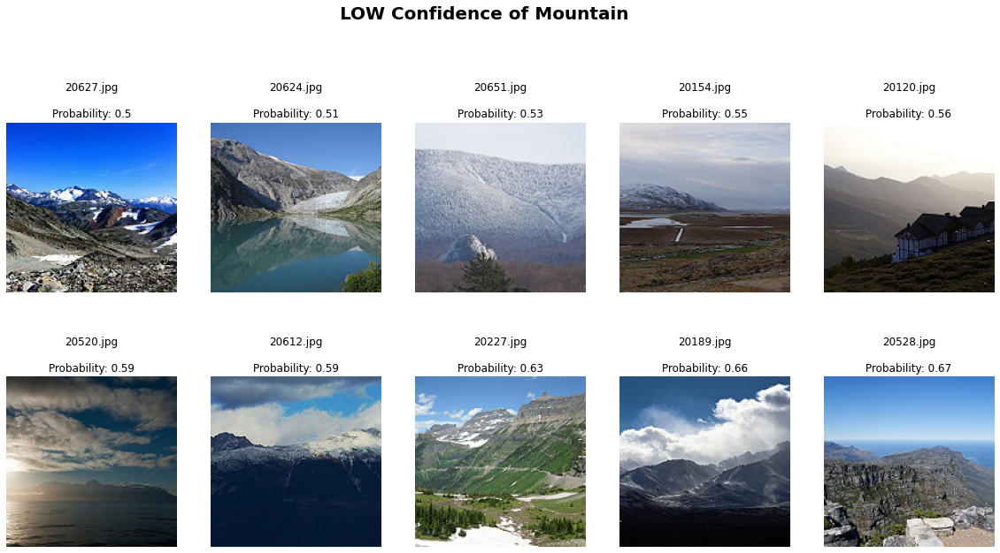

In [109]:
message = 'LOW Confidence of Mountain'
lowest_confident_mountain_images = get_images_with_sorted_probabilities(prediction_table, False, 3, 10, False)
display(lowest_confident_mountain_images, message)

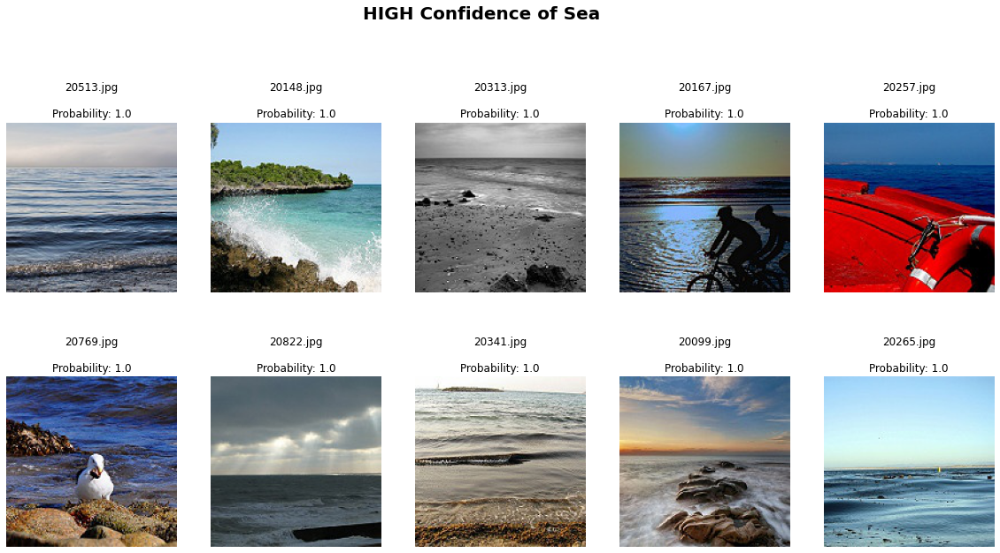

In [110]:
message = 'HIGH Confidence of Sea '
highest_confident_sea_images = get_images_with_sorted_probabilities(prediction_table, True, 4, 10, False)
display(highest_confident_sea_images, message) 

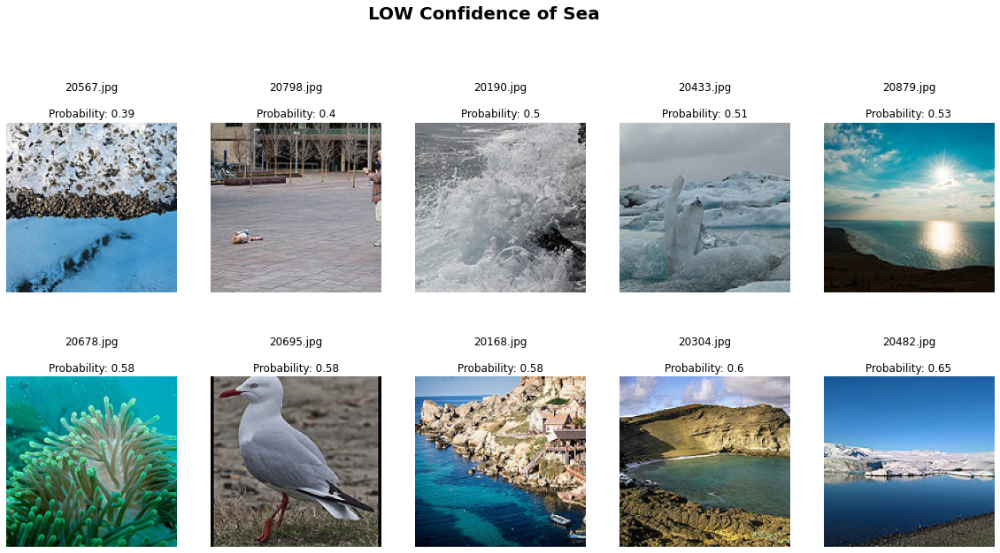

In [111]:
message = 'LOW Confidence of Sea'
lowest_confident_sea_images = get_images_with_sorted_probabilities(prediction_table, False, 4, 10, False)
display(lowest_confident_sea_images, message)

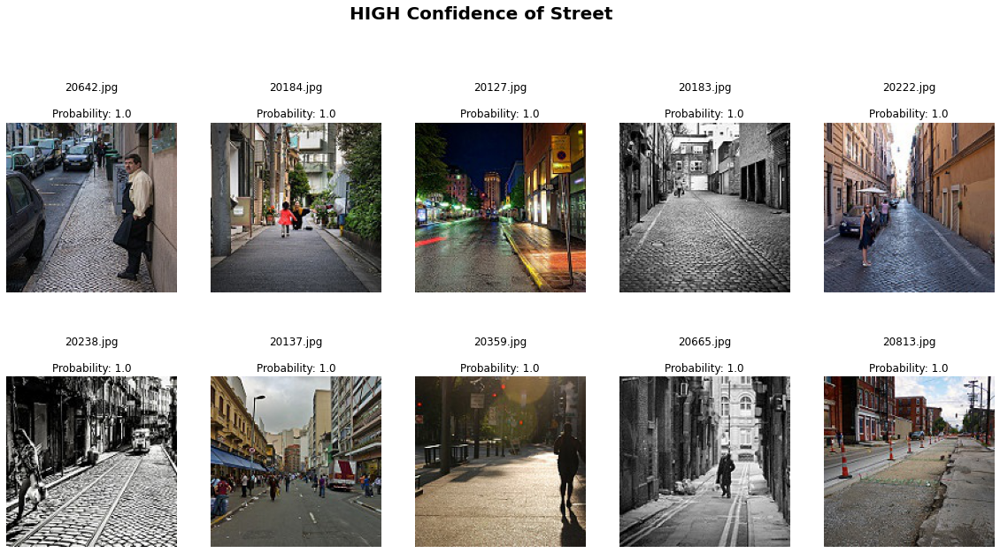

In [113]:
message = 'HIGH Confidence of Street '
highest_confident_street_images = get_images_with_sorted_probabilities(prediction_table, True, 5, 10, False)
display(highest_confident_street_images, message) 

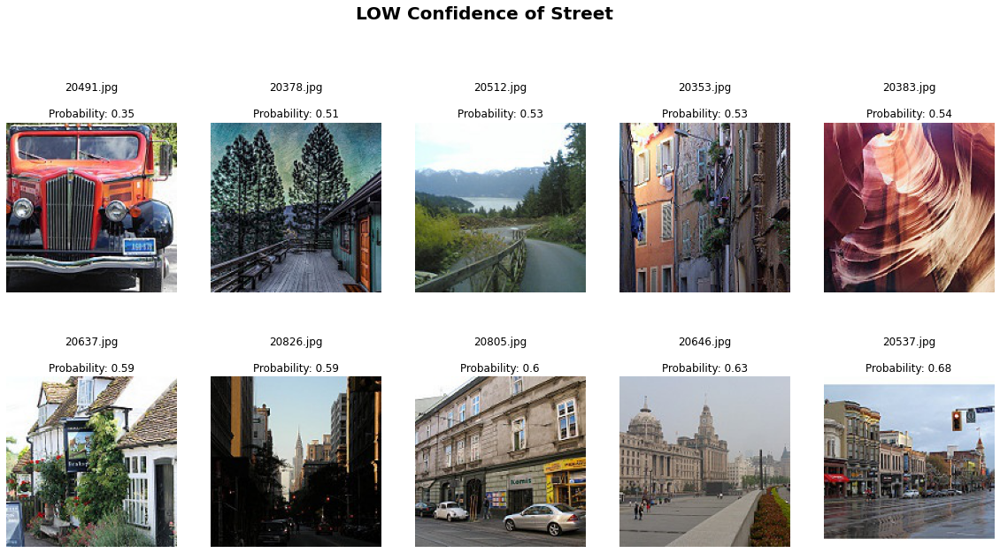

In [112]:
message = 'LOW Confidence of Street'
lowest_confident_street_images = get_images_with_sorted_probabilities(prediction_table, False, 5, 10, False)
display(lowest_confident_street_images, message)

##PREPARE FOR GRADCAM

In [138]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from PIL import Image

import os
import shutil   
import zipfile

In [114]:
# plotting functions
def get_img_array(img_path, img_size):
    # `img` is a PIL image
    img = keras.preprocessing.image.load_img(img_path, target_size=(img_size,img_size)) # load and resize
    array = keras.preprocessing.image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    # array = preprocess_input(array)     # comment this line if model includes a preprocessing layer
    return array

def plot_image_with_pred(img_path, model, labels, img_size=224):
    # display part
    img = Image.open(img_path)
    img =  img.resize((img_size,img_size))   # resize to mimic model's input
    img = np.array(img)
    plt.imshow(img)
    # prediction part
    img_array = get_img_array(img_path, img_size)
    preds = model.predict(img_array)
    plt.title(f'Prediction: {labels[preds.argmax(axis=1)[0]]}, with {round(preds.max()*100,2)}%')
    return img_array

In [116]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, classifier_layer_names, base_model_idx, pretrained=True):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer
    if pretrained:
        last_conv_layer = model.layers[base_model_idx].get_layer(last_conv_layer_name)
        last_conv_layer_model = keras.Model(model.layers[base_model_idx].inputs, last_conv_layer.output)
    else:
        last_conv_layer = model.get_layer(last_conv_layer_name)
        last_conv_layer_model = keras.Model(model.inputs, last_conv_layer.output)

        
    # Second, we create a model that maps the activations of the last conv
    # layer to the final class predictions
    classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
    x = classifier_input
    
    for layer_name in classifier_layer_names:
      try:
          x = model.get_layer(layer_name)(x)
      except:
          x = model.layers[base_model_idx].get_layer(layer_name)(x)  
    classifier_model = keras.Model(classifier_input, x)

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        # Compute activations of the last conv layer and make the tape watch it
        last_conv_layer_output = last_conv_layer_model(img_array)
        tape.watch(last_conv_layer_output)
        # Compute class predictions
        preds = classifier_model(last_conv_layer_output)
        top_pred_index = tf.argmax(preds[0])
        top_class_channel = preds[:, top_pred_index] # the f function

    # This is the gradient of the top predicted class with regard to
    # the output feature map of the last conv layer
    grads = tape.gradient(top_class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    last_conv_layer_output = last_conv_layer_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()
    for i in range(pooled_grads.shape[-1]):
        last_conv_layer_output[:, :, i] *= pooled_grads[i]

    # The channel-wise mean of the resulting feature map
    # is our heatmap of class activation
    heatmap = np.mean(last_conv_layer_output, axis=-1)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = np.maximum(heatmap, 0) / np.max(heatmap)
    return heatmap

# We load the original image
def plot_with_heatmap(img_path, heatmap, img_size=224):
    img = keras.preprocessing.image.load_img(img_path, target_size=(img_size, img_size))
    img = keras.preprocessing.image.img_to_array(img)

    # We rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # We use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # We use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # We create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap  + img*0.6
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)
    
    fig, axes = plt.subplots(2, 1, figsize=(10,10))
    step = img_size//7
    axes[0].set_xticks([x*step for x in range(1,7)])
    axes[0].set_yticks([x*step for x in range(1,7)])
    axes[0].imshow(jet_heatmap.astype(int))
    axes[1].set_xticks([x*step for x in range(1,7)])
    axes[0].set_yticks([x*step for x in range(1,7)])
    axes[1].imshow(superimposed_img)
    

In [115]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   
 ional)                                                          
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                      

In [117]:
model.layers[3].summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                              

Now we can see that the last Conv layer is at index -3. We can print out to check!

In [118]:
model.layers[3].layers[-5:]

🌟 In order to work, GradCAM needs:


1.   Index of the base model
2.   Index of the last conv layer
3.   Name of the rest following layers


In [119]:
# IMPORTANT
base_model_idx = 3  # <<<<<
last_conv_idx = -3  # <<<<<

last_conv_layer_name = model.layers[base_model_idx].layers[last_conv_idx].name # destination layer
the_rest_names = [i.name for i in model.layers[base_model_idx].layers[last_conv_idx+1:]] + [j.name for j in model.layers[(base_model_idx+1):]]

# CHECK
print(last_conv_layer_name, '\n')
print(the_rest_names)

Conv_1 

['Conv_1_bn', 'out_relu', 'global_average_pooling2d', 'dropout', 'dense']


In [120]:
def display_everything(path, last_conv_layer_name, the_rest_names, base_model_idx):
  img_path = path
  
  img_array = plot_image_with_pred(img_path, model,labels=list(train_generator.class_indices.keys()))
  
  heatmap = make_gradcam_heatmap(img_array, model, 
                                last_conv_layer_name, 
                                the_rest_names,
                                base_model_idx)
  
  plot_with_heatmap(img_path,heatmap)

In [122]:
filenames = validation_generator.filenames
img_paths = list(map(lambda x: str(validation_dir/x), filenames))  # Full path

In [125]:
predictions = model.predict(validation_generator)
pred_indices = np.argmax(predictions,axis=1)

ground_truth = validation_generator.classes

wrong_pred_paths = np.array(img_paths)[(pred_indices != ground_truth)]

print("Total wrong predictions:", len(wrong_pred_paths), '\n')
wrong_pred_paths

Total wrong predictions: 58 



array(['/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20083.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20390.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20637.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20646.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20805.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20826.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/forest/20416.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/forest/20605.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/glacier/20227.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/glacier/20317.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/glacier/20355.jpg',
       '/content/gdrive/MyDrive/week7_project/seg_test/seg_test/gl

In [148]:
def plot_images(img_paths, message, img_size=224):
    plt.figure(figsize=(40, 40))
    columns = 7
    for i, img_path in enumerate(img_paths):
        # predict
        img_array = get_img_array(img_path, img_size)
        predictions = model.predict(img_array)

        # setup
        ax = plt.subplot(len(img_paths) / columns + 1, columns, i + 1)
        ax.set_title(img_paths[i].split("/")[-1] + "\n" +
                     "\nProbability: " + str(float("{0:.1f}".format(predictions.max()*100))))
        plt.suptitle(message, fontsize=20, fontweight='bold')
        plt.axis('off')
        
        # show
        img = Image.open(img_path)
        img = np.array(img)
        plt.imshow(img)

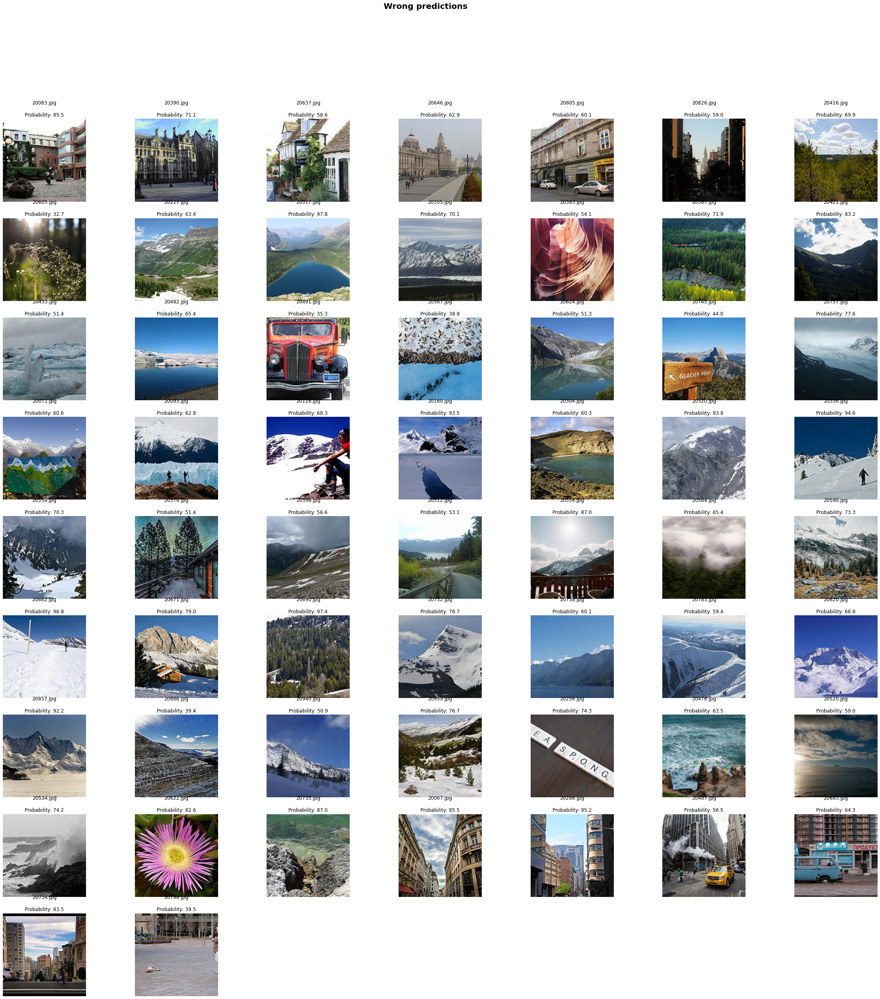

In [149]:
plot_images(wrong_pred_paths, "Wrong predictions")
plt.show()

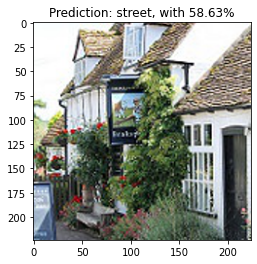

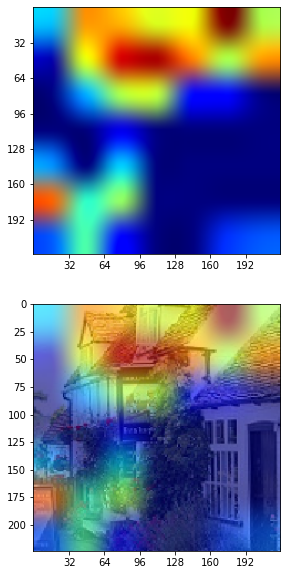

In [139]:
heatmap = display_everything(wrong_pred_paths[2], last_conv_layer_name, the_rest_names, base_model_idx)

In [ ]:
#/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20140.jpg

/content/gdrive/MyDrive/week7_project/seg_test/seg_test/buildings/20140.jpg 



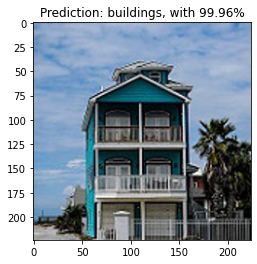

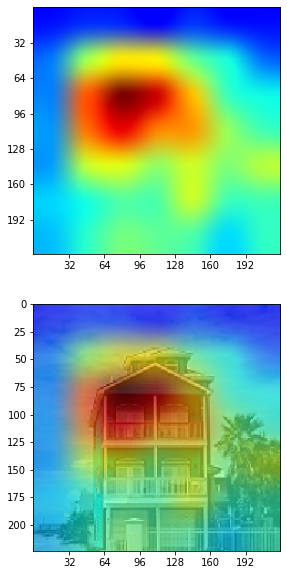

In [140]:
img_path = validation_dir/'buildings/20140.jpg'
print(img_path, '\n')

display_everything(img_path, last_conv_layer_name, the_rest_names, base_model_idx)

In [ ]:
#/content/gdrive/MyDrive/week7_project/seg_test/seg_test/street/21494.jpg

/content/gdrive/MyDrive/week7_project/seg_test/seg_test/street/21494.jpg 



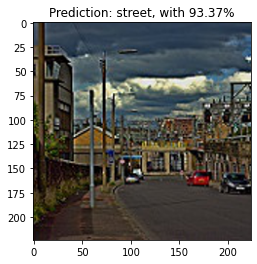

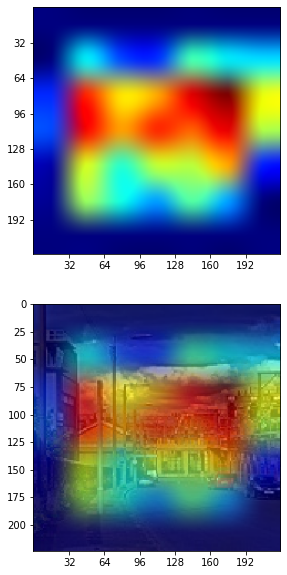

In [142]:
img_path = validation_dir/'street/21494.jpg'
print(img_path, '\n')

display_everything(img_path, last_conv_layer_name, the_rest_names, base_model_idx)